### imports

In [74]:
import pandas as pd
import numpy as np
from PIL import Image
import io
import tensorflow as tf
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
%matplotlib inline

# Image

In [45]:
df = pd.read_parquet('data/camera_image/training_camera_image_10017090168044687777_6380_000_6400_000.parquet')
df.rename(columns={'key.camera_name':'camera_name', 
                   '[CameraImageComponent].image':'image',
                   'key.frame_timestamp_micros':'timestamp_micros'}, inplace=True)
display(df.info())
df.head(6)

<class 'pandas.core.frame.DataFrame'>
Index: 990 entries, 10017090168044687777_6380_000_6400_000;1550083467346370 to 10017090168044687777_6380_000_6400_000;1550083487048517
Data columns (total 15 columns):
 #   Column                                                                  Non-Null Count  Dtype  
---  ------                                                                  --------------  -----  
 0   key.segment_context_name                                                990 non-null    object 
 1   timestamp_micros                                                        990 non-null    int64  
 2   camera_name                                                             990 non-null    int8   
 3   image                                                                   990 non-null    object 
 4   [CameraImageComponent].pose.transform                                   990 non-null    object 
 5   [CameraImageComponent].velocity.linear_velocity.x                       990 non-nu

None

,key.segment_context_name,timestamp_micros,camera_name,image,[CameraImageComponent].pose.transform,[CameraImageComponent].velocity.linear_velocity.x,[CameraImageComponent].velocity.linear_velocity.y,[CameraImageComponent].velocity.linear_velocity.z,[CameraImageComponent].velocity.angular_velocity.x,[CameraImageComponent].velocity.angular_velocity.y,[CameraImageComponent].velocity.angular_velocity.z,[CameraImageComponent].pose_timestamp,[CameraImageComponent].rolling_shutter_params.shutter,[CameraImageComponent].rolling_shutter_params.camera_trigger_time,[CameraImageComponent].rolling_shutter_params.camera_readout_done_time
index,,,,,,,,,,,,,,,
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...,"[0.9482868309813268, -0.23495154098744556, 0.2...",5.765131,1.371270,-1.329111,-0.010016,-0.014922,0.105475,1.550083e+09,0.009992,1.550083e+09,1.550083e+09
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,2,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...,"[0.9487161220058431, -0.23293730459068215, 0.2...",5.757565,1.392409,-1.327417,0.003401,-0.011684,0.099375,1.550083e+09,0.009992,1.550083e+09,1.550083e+09
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,4,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...,"[0.9489391880311817, -0.23197163266142976, 0.2...",5.762588,1.389895,-1.330847,0.005329,-0.012516,0.098726,1.550083e+09,0.009992,1.550083e+09,1.550083e+09
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,3,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...,"[0.9480805733268344, -0.23597955012227076, 0.2...",5.764107,1.374694,-1.330062,-0.014756,-0.016971,0.102667,1.550083e+09,0.009992,1.550083e+09,1.550083e+09
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,5,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...,"[0.9479157488563362, -0.23691579285250022, 0.2...",5.758528,1.381121,-1.324764,-0.016695,-0.015307,0.097743,1.550083e+09,0.009992,1.550083e+09,1.550083e+09
10017090168044687777_6380_000_6400_000;1550083467446163,10017090168044687777_6380_000_6400_000,1550083467446163,1,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...,"[0.9460454274905595, -0.2446805774969256, 0.21...",5.726245,1.409312,-1.290130,-0.007733,0.002890,0.098458,1.550083e+09,0.009992,1.550083e+09,1.550083e+09


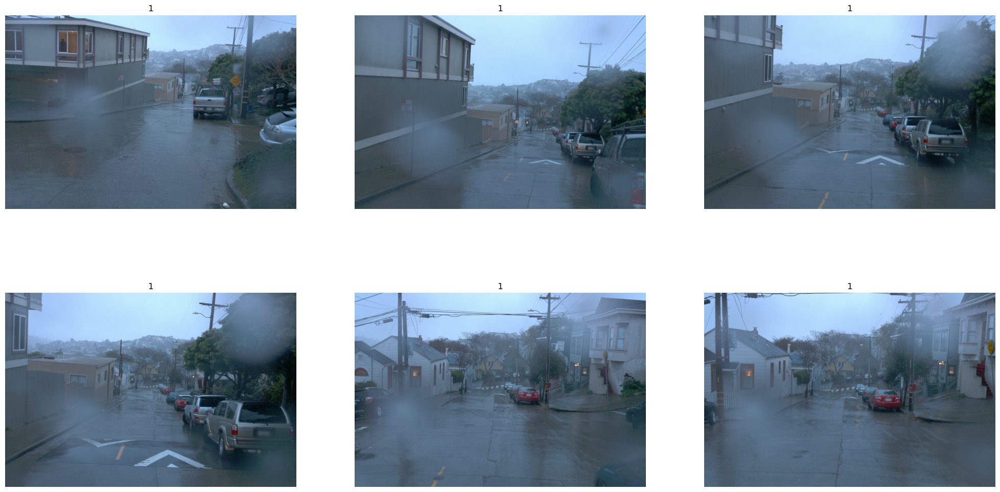

In [43]:
def show_camera_image(camera_image, layout):
  """Display the given camera image."""
  ax = plt.subplot(*layout)
  plt.imshow(tf.image.decode_jpeg(camera_image.image))
  plt.title(camera_image.camera_name)
  plt.grid(False)
  plt.axis('off')
  return ax

cam1 = df.loc[df['camera_name'] == 1].sample(6).sort_values(by='key.frame_timestamp_micros')

plt.figure(figsize=(25, 20))

for index in range(cam1.shape[0]):
  _ = show_camera_image(cam1.iloc[index], [3, 3, index + 1])

# Camera Box

In [46]:
box_df = pd.read_parquet('data/camera_box/training_camera_box_10017090168044687777_6380_000_6400_000.parquet')
box_df.rename(columns={'key.camera_name':'camera_name', 
                       'key.frame_timestamp_micros':'timestamp_micros'}, inplace=True)
display(box_df.info())
box_df.head()

<class 'pandas.core.frame.DataFrame'>
Index: 4308 entries, 10017090168044687777_6380_000_6400_000;1550083467346370 to 10017090168044687777_6380_000_6400_000;1550083487048517
Data columns (total 11 columns):
 #   Column                                           Non-Null Count  Dtype  
---  ------                                           --------------  -----  
 0   key.segment_context_name                         4308 non-null   object 
 1   timestamp_micros                                 4308 non-null   int64  
 2   camera_name                                      4308 non-null   int8   
 3   key.camera_object_id                             4308 non-null   object 
 4   [CameraBoxComponent].box.center.x                4308 non-null   float64
 5   [CameraBoxComponent].box.center.y                4308 non-null   float64
 6   [CameraBoxComponent].box.size.x                  4308 non-null   float64
 7   [CameraBoxComponent].box.size.y                  4308 non-null   float64
 8   [CameraB

None

,key.segment_context_name,timestamp_micros,camera_name,key.camera_object_id,[CameraBoxComponent].box.center.x,[CameraBoxComponent].box.center.y,[CameraBoxComponent].box.size.x,[CameraBoxComponent].box.size.y,[CameraBoxComponent].type,[CameraBoxComponent].difficulty_level.detection,[CameraBoxComponent].difficulty_level.tracking
index,,,,,,,,,,,
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,12ba81ee-9cee-4134-94ca-df9ed01e0ff1,1466.55198,492.64020,240.63579,109.89666,1,NaN,NaN
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,2ab9ff55-a510-435b-a729-884444e67249,1109.07204,536.85150,178.73997,156.00273,1,NaN,NaN
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,470e3826-ecd2-425c-80ca-33f3d8c876a6,1181.70489,519.16698,61.89582,95.37009,1,NaN,NaN
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,98fcf17a-d19e-4c3b-bbc0-54ae2d1fcc15,1006.12287,486.95589,28.42155,39.15858,1,NaN,NaN
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,fb06fe05-95ee-43dc-801c-7855e4fbd7f1,1380.02415,603.80004,361.26948,127.58118,1,NaN,NaN


In [5]:
box_df['key.camera_object_id'].value_counts()

66355bd8-db76-4a7c-99e6-3294a45825c1    177
1fa40b66-1897-4d0b-93e9-a9445372962b    175
fb33b618-2389-427b-bd05-71493d94e99c    175
b1a13fc5-74fe-416f-880b-51ee351b49c0    162
66521395-87a2-4a07-99a4-be98fff66d33    159
                                       ... 
2a1ce1dc-d964-41dd-baa5-9e8896a25074      4
97dd95e6-42d3-4f44-970f-9cf6a361274b      4
e5e2e33b-ad83-40ba-aff7-3497cbb71f0c      3
ad7d400f-617e-46a7-a1b2-517f688c21fd      3
06437ddb-31f3-42ef-8421-102674ccb38a      2
Name: key.camera_object_id, Length: 121, dtype: int64

# Camera Segmentation

In [6]:
seg_df = pd.read_parquet('data/camera_segmentation/training_camera_segmentation_10017090168044687777_6380_000_6400_000.parquet')
display(seg_df.info())
seg_df.head()

<class 'pandas.core.frame.DataFrame'>
Index: 100 entries, 10017090168044687777_6380_000_6400_000;1550083469645130 to 10017090168044687777_6380_000_6400_000;1550083485848817
Data columns (total 10 columns):
 #   Column                                                                                   Non-Null Count  Dtype 
---  ------                                                                                   --------------  ----- 
 0   key.segment_context_name                                                                 100 non-null    object
 1   key.frame_timestamp_micros                                                               100 non-null    int64 
 2   key.camera_name                                                                          100 non-null    int8  
 3   [CameraSegmentationLabelComponent].panoptic_label_divisor                                100 non-null    int32 
 4   [CameraSegmentationLabelComponent].panoptic_label                                      

None

,key.segment_context_name,key.frame_timestamp_micros,key.camera_name,[CameraSegmentationLabelComponent].panoptic_label_divisor,[CameraSegmentationLabelComponent].panoptic_label,[CameraSegmentationLabelComponent].instance_id_to_global_id_mapping.local_instance_ids,[CameraSegmentationLabelComponent].instance_id_to_global_id_mapping.global_instance_ids,[CameraSegmentationLabelComponent].instance_id_to_global_id_mapping.is_tracked,[CameraSegmentationLabelComponent].sequence_id,[CameraSegmentationLabelComponent].num_cameras_covered
index,,,,,,,,,,
10017090168044687777_6380_000_6400_000;1550083469645130,10017090168044687777_6380_000_6400_000,1550083469645130,1,1000,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...,"[1, 2, 3, 4]","[9, 10, 11, 41]","[True, True, True, True]",17766991336812920378,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...
10017090168044687777_6380_000_6400_000;1550083469645130,10017090168044687777_6380_000_6400_000,1550083469645130,2,1000,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...,"[1, 2, 3, 4]","[3, 6, 7, 8]","[True, True, True, True]",17766991336812920378,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...
10017090168044687777_6380_000_6400_000;1550083469645130,10017090168044687777_6380_000_6400_000,1550083469645130,4,1000,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 40]","[True, True, True, True, True, True]",17766991336812920378,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...
10017090168044687777_6380_000_6400_000;1550083469645130,10017090168044687777_6380_000_6400_000,1550083469645130,3,1000,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...,"[1, 2]","[9, 12]","[True, True]",17766991336812920378,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...
10017090168044687777_6380_000_6400_000;1550083469645130,10017090168044687777_6380_000_6400_000,1550083469645130,5,1000,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...,[],[],[],17766991336812920378,b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\...


In [29]:
cam1_seg = seg_df.loc[seg_df['key.camera_name']==1]['[CameraSegmentationLabelComponent].panoptic_label']
jpeg_bytes = cam1_seg.iloc[4]
# create an Image object from the bytes
img = Image.open(io.BytesIO(jpeg_bytes))
# display the image
img.show()

In [28]:
cam1 = df.loc[df['key.camera_name'] == 1]['[CameraImageComponent].image']
jpeg_bytes = cam1.iloc[4]
# create an Image object from the bytes
img = Image.open(io.BytesIO(jpeg_bytes))
# display the image
img.show()

# Joining Images and Boxes

In [88]:
joined.groupby('object_id').mean().sort_values(by='box_size_x', ascending=False).index

/var/folders/q2/gldktxqd3tx2f_pmssngnvbm0000gn/T/ipykernel_34930/923165755.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  joined.groupby('object_id').mean().sort_values(by='box_size_x', ascending=False).index[:6]


Index(['fb06fe05-95ee-43dc-801c-7855e4fbd7f1',
       'f0ac0b31-d210-4720-8fb8-64a71d795318',
       '2ab9ff55-a510-435b-a729-884444e67249',
       '470e3826-ecd2-425c-80ca-33f3d8c876a6',
       '12ba81ee-9cee-4134-94ca-df9ed01e0ff1',
       '45c90e2f-3f6b-4238-b8e9-8082d215b711'],
      dtype='object', name='object_id')

In [89]:
cam1_imgs = df.loc[df.camera_name == 1]
cam1_boxes = box_df.loc[box_df.camera_name == 1]
joined = cam1_boxes.join(cam1_imgs[['image']])
joined.rename(columns={'key.camera_object_id':'object_id',
                       '[CameraBoxComponent].box.center.x':'box_center_x',
                       '[CameraBoxComponent].box.center.y':'box_center_y',
                       '[CameraBoxComponent].box.size.x':'box_size_x',
                       '[CameraBoxComponent].box.size.y':'box_size_y'}, inplace=True)

# get partition by object labels with largest box sizes
obj_dfs = []
gb = joined.groupby('object_id').mean().sort_values(by='box_size_x', ascending=False)
for i in range(6):
    this_obj_id = gb.index[i]
    obj_dfs.append(joined.loc[joined['object_id'] == this_obj_id])
joined

/var/folders/q2/gldktxqd3tx2f_pmssngnvbm0000gn/T/ipykernel_34930/3580043747.py:13: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  this_obj_id = joined.groupby('object_id').mean().sort_values(by='box_size_x', ascending=False).index[i]
/var/folders/q2/gldktxqd3tx2f_pmssngnvbm0000gn/T/ipykernel_34930/3580043747.py:13: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  this_obj_id = joined.groupby('object_id').mean().sort_values(by='box_size_x', ascending=False).index[i]
/var/folders/q2/gldktxqd3tx2f_pmssngnvbm0000gn/T/ipykernel_34930/3580043747.py:13: FutureWarning: The default value of numeric_only in DataFrameGrou

,key.segment_context_name,timestamp_micros,camera_name,object_id,box_center_x,box_center_y,box_size_x,box_size_y,[CameraBoxComponent].type,[CameraBoxComponent].difficulty_level.detection,[CameraBoxComponent].difficulty_level.tracking,image
index,,,,,,,,,,,,
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,12ba81ee-9cee-4134-94ca-df9ed01e0ff1,1466.55198,492.64020,240.63579,109.89666,1,NaN,NaN,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,2ab9ff55-a510-435b-a729-884444e67249,1109.07204,536.85150,178.73997,156.00273,1,NaN,NaN,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,470e3826-ecd2-425c-80ca-33f3d8c876a6,1181.70489,519.16698,61.89582,95.37009,1,NaN,NaN,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,98fcf17a-d19e-4c3b-bbc0-54ae2d1fcc15,1006.12287,486.95589,28.42155,39.15858,1,NaN,NaN,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
10017090168044687777_6380_000_6400_000;1550083467346370,10017090168044687777_6380_000_6400_000,1550083467346370,1,fb06fe05-95ee-43dc-801c-7855e4fbd7f1,1380.02415,603.80004,361.26948,127.58118,1,NaN,NaN,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
...,...,...,...,...,...,...,...,...,...,...,...,...
10017090168044687777_6380_000_6400_000;1550083487048517,10017090168044687777_6380_000_6400_000,1550083487048517,1,72f1f7c8-3c47-4083-8792-30de6b81097f,1475.39424,589.90506,85.26465,85.26465,1,NaN,NaN,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
10017090168044687777_6380_000_6400_000;1550083487048517,10017090168044687777_6380_000_6400_000,1550083487048517,1,7df7020f-c391-4558-8e2e-96f3bc167846,1498.76307,506.53518,53.05356,51.15879,1,NaN,NaN,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
10017090168044687777_6380_000_6400_000;1550083487048517,10017090168044687777_6380_000_6400_000,1550083487048517,1,820f2a5f-8cf8-4fdf-95ba-d41ad254b381,1486.13127,541.90422,70.73808,49.89561,1,NaN,NaN,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...


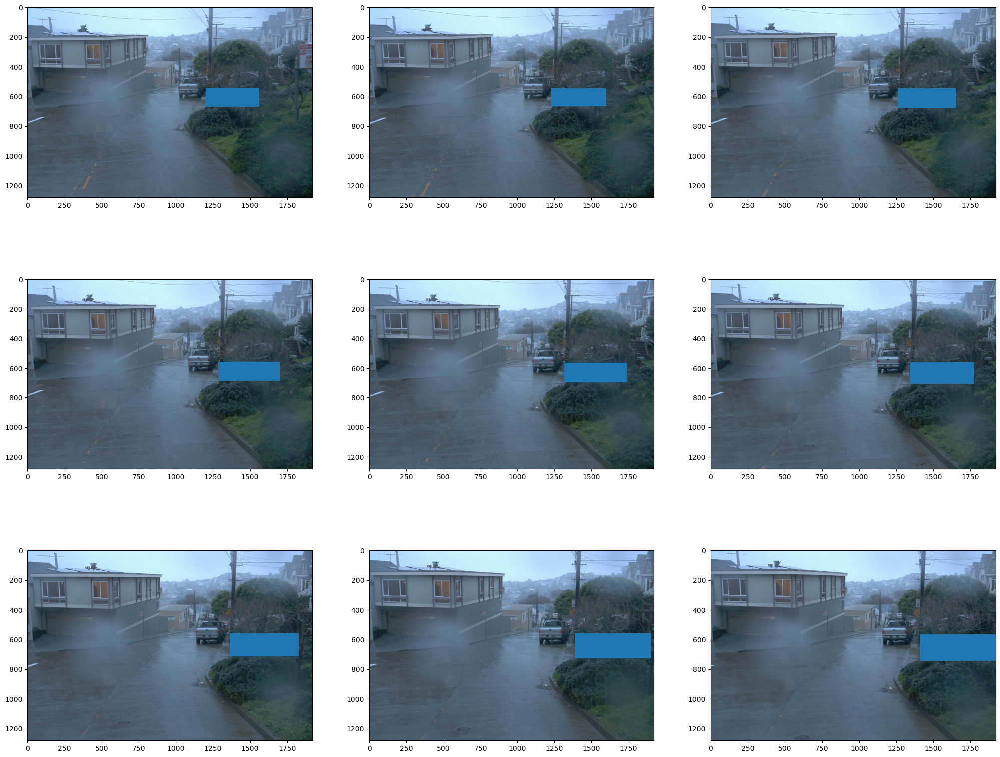

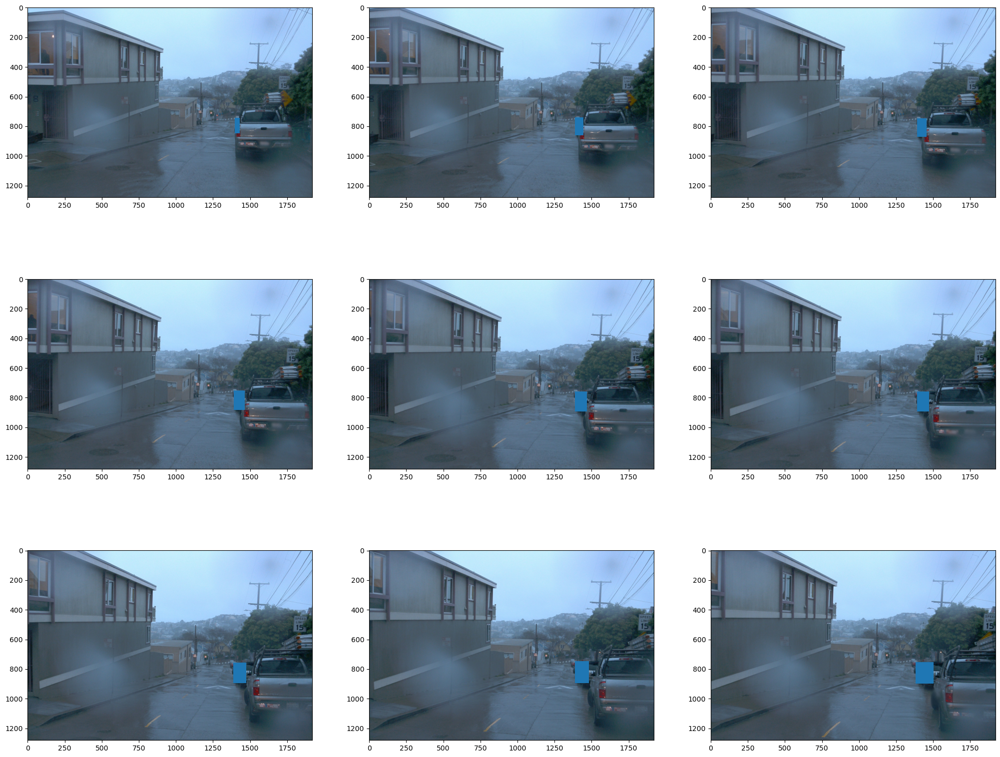

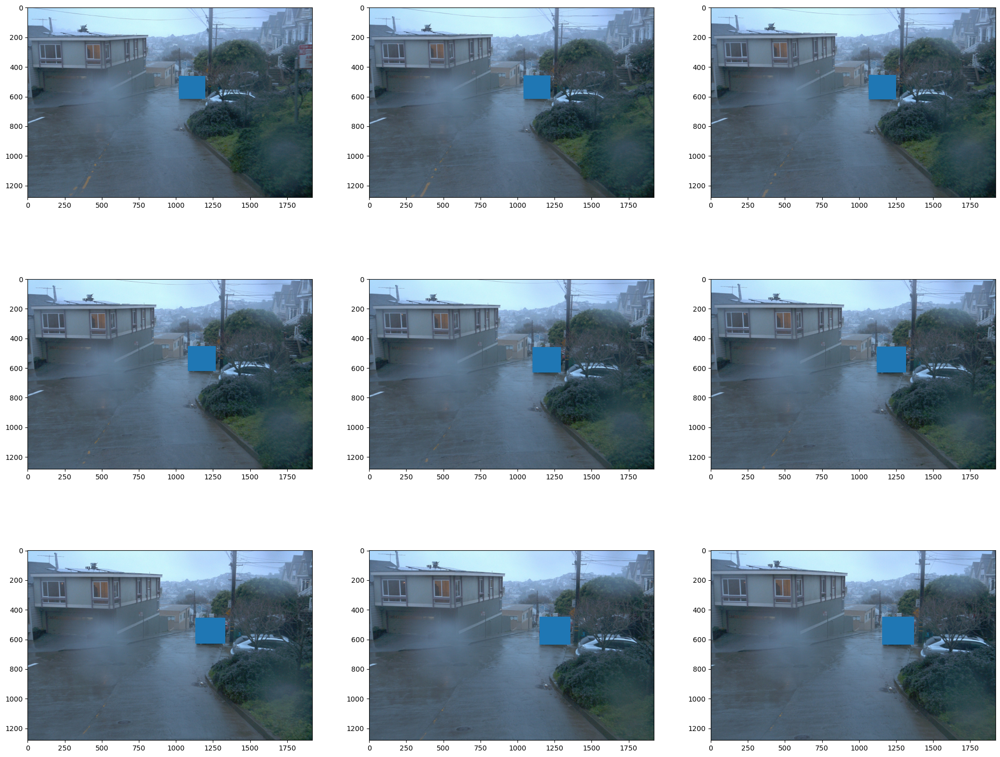

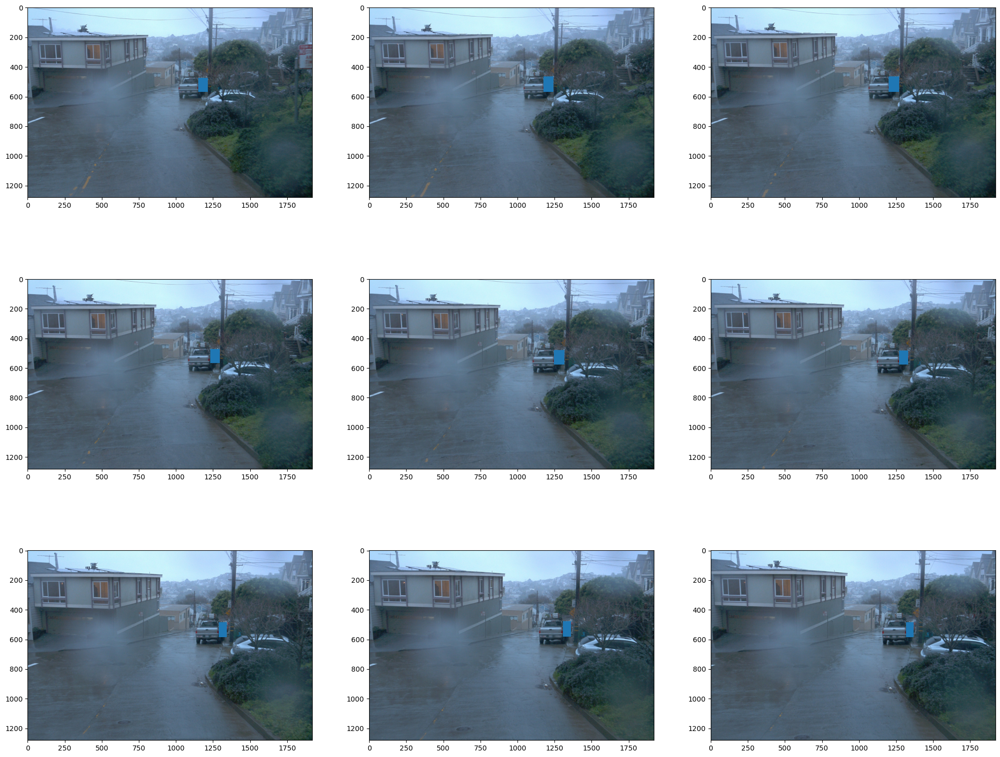

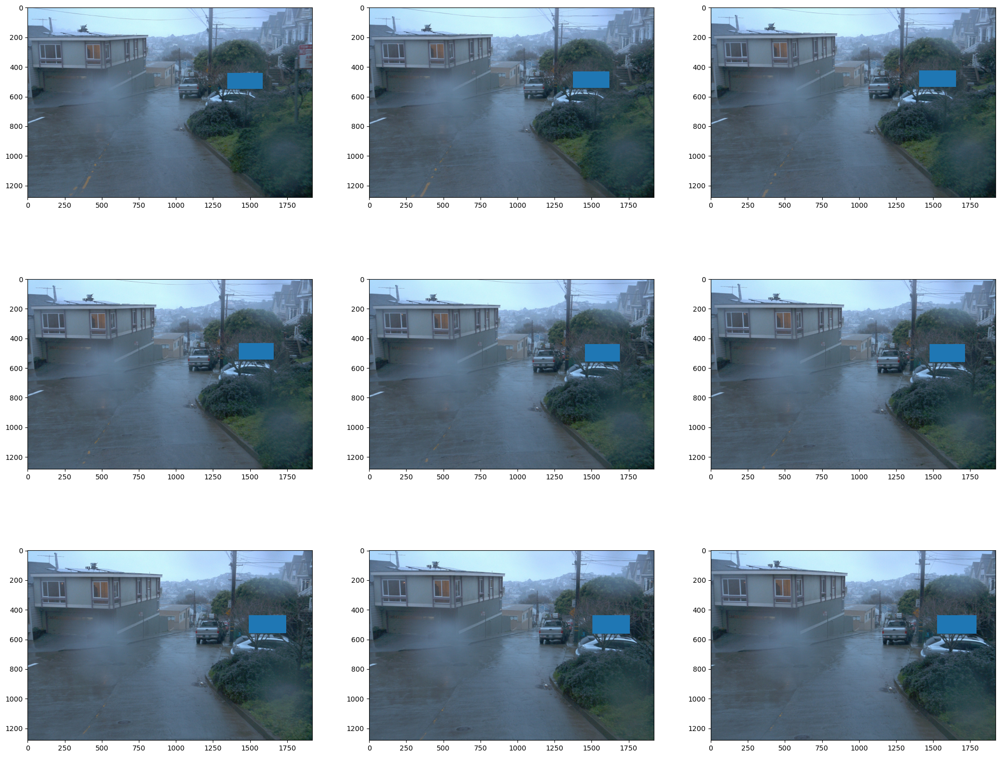

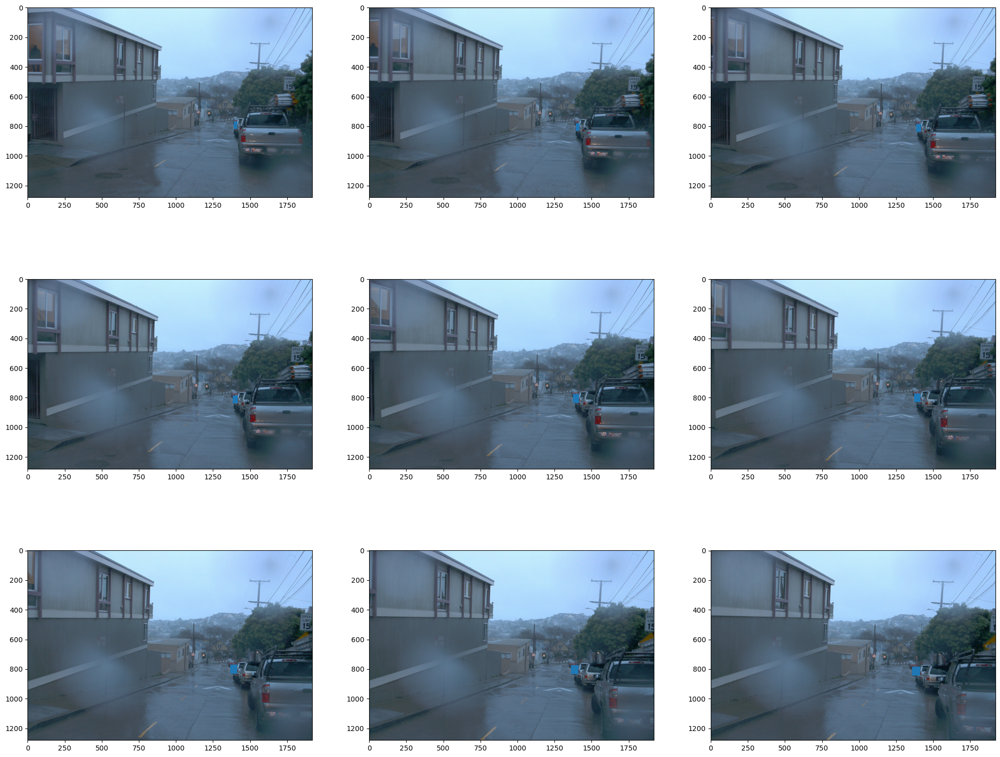

In [90]:
def show_camera_image(camera_image, layout):
  """Display the given camera image."""
  ax = plt.subplot(*layout)
  plt.imshow(tf.image.decode_jpeg(camera_image.image))
  lower_left_x = camera_image.box_center_x - (camera_image.box_size_x // 2)
  lower_left_y = camera_image.box_center_y - (camera_image.box_size_y // 2)
  ax.add_patch(Rectangle((lower_left_x, lower_left_y), 
                         camera_image.box_size_x, 
                         camera_image.box_size_y))
  plt.grid(False)
  # plt.axis('off')
  return ax

for obj_df in obj_dfs:
  plt.figure(figsize=(25, 20))

  for index in range(obj_df.head(9).shape[0]):
    _ = show_camera_image(obj_df.iloc[index], [3, 3, index + 1])